# <center> Sprints Capstone Project </center>

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy import stats
from sklearn import preprocessing
import plotly_express as px
import squarify as sq
import scipy.stats as st

# 'Test.csv' File

In [2]:
data2=pd.read_csv('test_users.csv')
data2

,id,date_account_created,timestamp_first_active,date_first_booking,gender,age,signup_method,signup_flow,language,affiliate_channel,affiliate_provider,first_affiliate_tracked,signup_app,first_device_type,first_browser
0,5uwns89zht,2014-07-01,20140701000006,NaN,FEMALE,35.0,facebook,0,en,direct,direct,untracked,Moweb,iPhone,Mobile Safari
1,jtl0dijy2j,2014-07-01,20140701000051,NaN,-unknown-,NaN,basic,0,en,direct,direct,untracked,Moweb,iPhone,Mobile Safari
2,xx0ulgorjt,2014-07-01,20140701000148,NaN,-unknown-,NaN,basic,0,en,direct,direct,linked,Web,Windows Desktop,Chrome
3,6c6puo6ix0,2014-07-01,20140701000215,NaN,-unknown-,NaN,basic,0,en,direct,direct,linked,Web,Windows Desktop,IE
4,czqhjk3yfe,2014-07-01,20140701000305,NaN,-unknown-,NaN,basic,0,en,direct,direct,untracked,Web,Mac Desktop,Safari
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
62091,cv0na2lf5a,2014-09-30,20140930235232,NaN,-unknown-,31.0,basic,0,en,direct,direct,untracked,Web,Windows Desktop,IE
62092,zp8xfonng8,2014-09-30,20140930235306,NaN,-unknown-,NaN,basic,23,ko,direct,direct,untracked,Android,Android Phone,-unknown-
62093,fa6260ziny,2014-09-30,20140930235408,NaN,-unknown-,NaN,basic,0,de,direct,direct,linked,Web,Windows Desktop,Firefox
62094,87k0fy4ugm,2014-09-30,20140930235430,NaN,-unknown-,NaN,basic,0,en,sem-brand,google,omg,Web,Mac Desktop,Safari


In [3]:
data2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 62096 entries, 0 to 62095
Data columns (total 15 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   id                       62096 non-null  object 
 1   date_account_created     62096 non-null  object 
 2   timestamp_first_active   62096 non-null  int64  
 3   date_first_booking       0 non-null      float64
 4   gender                   62096 non-null  object 
 5   age                      33220 non-null  float64
 6   signup_method            62096 non-null  object 
 7   signup_flow              62096 non-null  int64  
 8   language                 62096 non-null  object 
 9   affiliate_channel        62096 non-null  object 
 10  affiliate_provider       62096 non-null  object 
 11  first_affiliate_tracked  62076 non-null  object 
 12  signup_app               62096 non-null  object 
 13  first_device_type        62096 non-null  object 
 14  first_browser         

Wrong data type for 'date_account_created' and 'timestamp_first_active' fields.

In [4]:
data2['timestamp_first_active']=pd.to_datetime(data2['timestamp_first_active'], format='%Y%m%d%H%S%f')
data2['date_account_created']=pd.to_datetime(data2['date_account_created'])

In [5]:
#Checking for null values
data2.isnull().sum()

id                             0
date_account_created           0
timestamp_first_active         0
date_first_booking         62096
gender                         0
age                        28876
signup_method                  0
signup_flow                    0
language                       0
affiliate_channel              0
affiliate_provider             0
first_affiliate_tracked       20
signup_app                     0
first_device_type              0
first_browser                  0
dtype: int64

All values of 'date_first_booking' column are null, so we will drop it.

In [6]:
data2.drop('date_first_booking',axis=1, inplace= True) #Data Cleaning Process

In [7]:
#Checking for duplicates
data2.duplicated().sum()

0

### EDA Process

In [8]:
data2.describe()

,age,signup_flow
count,33220.000000,62096.000000
mean,37.616677,7.813885
std,74.440647,11.254291
min,1.000000,0.000000
25%,26.000000,0.000000
50%,31.000000,0.000000
75%,40.000000,23.000000
max,2002.000000,25.000000


#### Box plotting to check for outliers

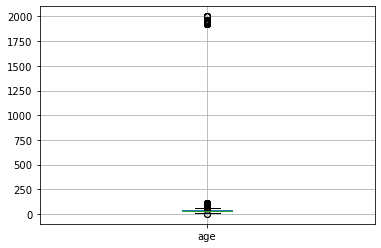

In [9]:
data2[["age"]].boxplot();

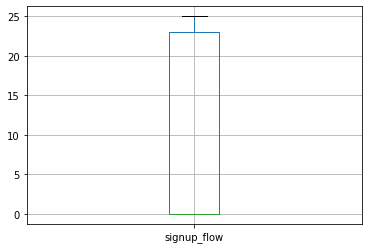

In [10]:
data2[["signup_flow"]].boxplot();

### Data Cleaning Process

#### Applying Z-score to remove oultliers 

In [11]:
z = np.abs(stats.zscore(data2['age']))
z

0       NaN
1       NaN
2       NaN
3       NaN
4       NaN
         ..
62091   NaN
62092   NaN
62093   NaN
62094   NaN
62095   NaN
Name: age, Length: 62096, dtype: float64

In [12]:
data2.isnull().sum()

id                             0
date_account_created           0
timestamp_first_active         0
gender                         0
age                        28876
signup_method                  0
signup_flow                    0
language                       0
affiliate_channel              0
affiliate_provider             0
first_affiliate_tracked       20
signup_app                     0
first_device_type              0
first_browser                  0
dtype: int64

In [13]:
#Removing null values to apply Z-score normalization
data2= data2[data2['age'].notna()]

In [14]:
z = np.abs(stats.zscore(data2['age']))
print(z)

0        0.035152
5        0.129188
6        0.139487
11       0.102320
12       0.182923
           ...   
62087    0.233523
62088    0.048585
62089    0.075453
62091    0.088887
62095    0.152920
Name: age, Length: 33220, dtype: float64


In [15]:
data2.isnull().sum()

id                          0
date_account_created        0
timestamp_first_active      0
gender                      0
age                         0
signup_method               0
signup_flow                 0
language                    0
affiliate_channel           0
affiliate_provider          0
first_affiliate_tracked    12
signup_app                  0
first_device_type           0
first_browser               0
dtype: int64

C:\Users\yarae\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


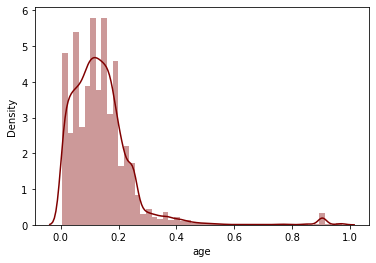

In [16]:
#Plotting 'age' histogram
sns.distplot(z[z<3], color="maroon");

# 'Sessions.csv' File

In [17]:
data3=pd.read_csv("sessions.csv")
data3

,user_id,action,action_type,action_detail,device_type,secs_elapsed
0,d1mm9tcy42,lookup,NaN,NaN,Windows Desktop,319.0
1,d1mm9tcy42,search_results,click,view_search_results,Windows Desktop,67753.0
2,d1mm9tcy42,lookup,NaN,NaN,Windows Desktop,301.0
3,d1mm9tcy42,search_results,click,view_search_results,Windows Desktop,22141.0
4,d1mm9tcy42,lookup,NaN,NaN,Windows Desktop,435.0
...,...,...,...,...,...,...
10567732,9uqfg8txu3,dashboard,view,dashboard,Windows Desktop,556.0
10567733,9uqfg8txu3,edit,view,edit_profile,Windows Desktop,6624.0
10567734,9uqfg8txu3,webcam_upload,-unknown-,-unknown-,Windows Desktop,200125.0
10567735,9uqfg8txu3,active,-unknown-,-unknown-,-unknown-,17624.0


In [18]:
data3.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10567737 entries, 0 to 10567736
Data columns (total 6 columns):
 #   Column         Dtype  
---  ------         -----  
 0   user_id        object 
 1   action         object 
 2   action_type    object 
 3   action_detail  object 
 4   device_type    object 
 5   secs_elapsed   float64
dtypes: float64(1), object(5)
memory usage: 483.8+ MB


### EDA Process

In [19]:
data3.describe()

,secs_elapsed
count,1.043171e+07
mean,1.940581e+04
std,8.888424e+04
min,0.000000e+00
25%,2.290000e+02
50%,1.147000e+03
75%,8.444000e+03
max,1.799977e+06


In [20]:
data3['action'].value_counts()

show              2768278
index              843699
search_results     725226
personalize        706824
search             536057
                   ...   
deauthorize             1
events                  1
reactivate              1
desks                   1
nyan                    1
Name: action, Length: 359, dtype: int64

In [21]:
data3['action_type'].value_counts()

view                3560902
data                2103770
click               1996183
-unknown-           1031170
submit               623357
message_post          87103
partner_callback      19132
booking_request       18773
modify                 1139
booking_response          4
Name: action_type, dtype: int64

we conclude that 'view' is the most action type taken and 'booking_response' is the least one.

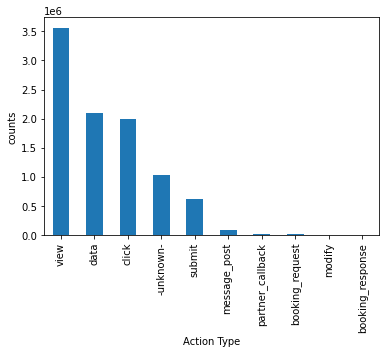

In [22]:
data3['action_type'].value_counts().plot(kind='bar')
plt.xlabel("Action Type")
plt.ylabel("counts")
plt.show()

In [23]:
data3['action_detail'].value_counts()

view_search_results         1776885
p3                          1376550
-unknown-                   1031141
wishlist_content_update      706824
user_profile                 656839
                             ...   
special_offer_field               3
tos_2014                          2
host_refund_guest                 2
host_respond_page                 2
host_standard_suspension          1
Name: action_detail, Length: 155, dtype: int64

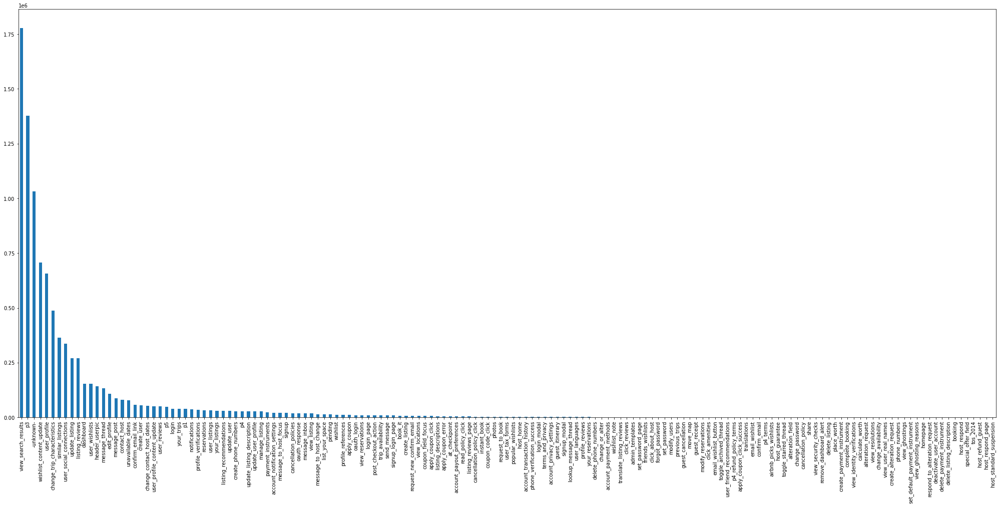

In [24]:
plt.figure(figsize=(35,15))
data3.action_detail.value_counts().plot.bar()
plt.show()

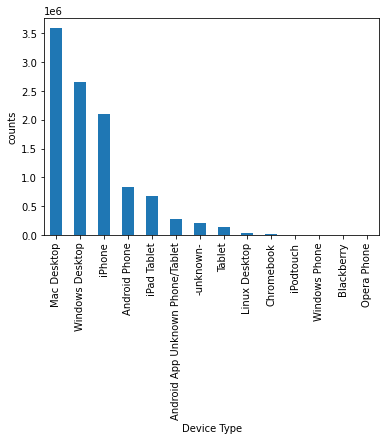

In [25]:
data3['device_type'].value_counts().plot(kind='bar')
plt.xlabel("Device Type")
plt.ylabel("counts")
plt.show()

It is observed that the most used device_type is 'Mac Desktop' and the least used one is 'Opera phone'.

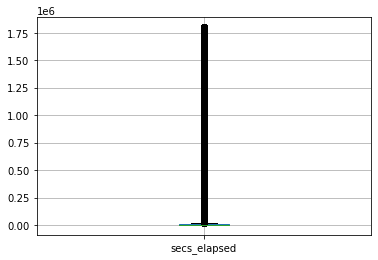

In [26]:
data3.boxplot(column="secs_elapsed")
plt.show()

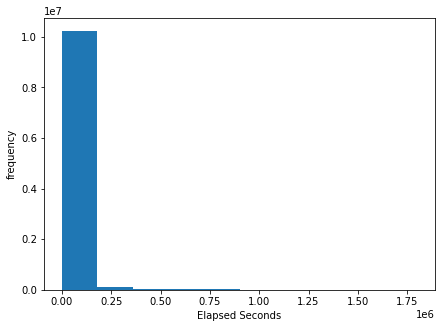

In [27]:
plt.figure(figsize=(7,5))
plt.hist(data3['secs_elapsed'])
plt.xlabel("Elapsed Seconds")
plt.ylabel("frequency")
plt.show()

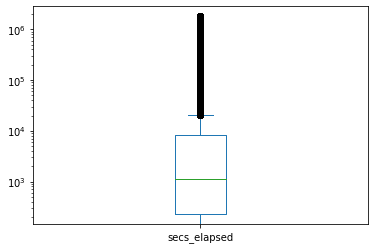

In [28]:
data3['secs_elapsed'].plot(kind='box')
plt.semilogy();

Notice the difference in the scale of values between the two box plots.  
"e6" means that the values are multiplied by 10 to the power 6 (10^6), which means that the plotted values are in terms of millions.

In [29]:
#There are a lot of outliers.
standard = pd.DataFrame(preprocessing.scale(data3['secs_elapsed']))
standard

,0
0,-0.214738
1,0.543934
2,-0.214940
3,0.030772
4,-0.213433
...,...
10567732,-0.212071
10567733,-0.143803
10567734,2.033197
10567735,-0.020046


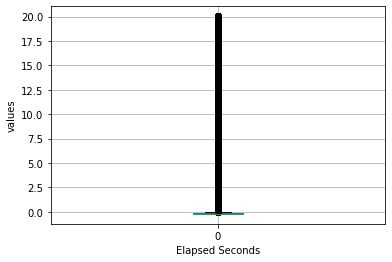

In [30]:
standard.boxplot()
plt.xlabel("Elapsed Seconds")
plt.ylabel("values")
plt.show()

The scale is different, while the values are not affected.

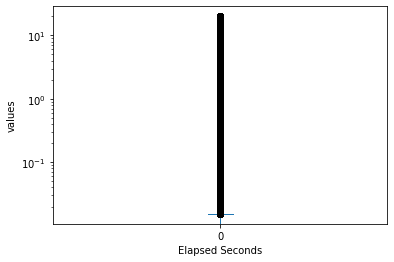

In [31]:
standard.plot(kind='box')
plt.xlabel("Elapsed Seconds")
plt.ylabel("values")
plt.semilogy();

Notice the difference in the scale of values.

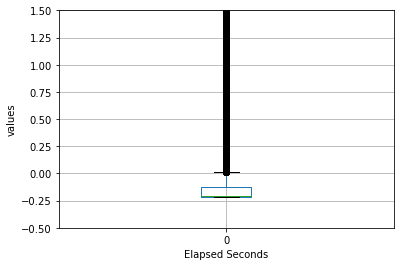

In [32]:
#Zooming through the box 
plt.ylim(-0.5,1.5)
plt.xlabel("Elapsed Seconds")
plt.ylabel("values")
standard.boxplot();

### Data Cleaning Process

In [33]:
#Checking for duplicate rows
data3.duplicated().sum()

252536

In [34]:
#Dropping duplicate rows
data3.drop_duplicates(inplace=True)

In [35]:
#Checking for null values in the whole dataset
data3.isnull().sum()

user_id            29308
action             78349
action_type      1071409
action_detail    1071409
device_type            0
secs_elapsed      135535
dtype: int64

In [36]:
#Dropping the rows that contain null values at 'user_id' field
data3= data3[data3['user_id'].notna()]

In [37]:
#Replacing the null values in'action' column with the mode of column values
data3['action'].fillna(data3.action.mode()[0], inplace=True)
#Replacing the null values at both 'action_type', and 'action_detail' columns in a certain row with the value at the previous row using 'backward fill' method 
data3['action_type'].fillna(method='bfill', inplace=True)
data3['action_detail'].fillna(method='bfill', inplace=True)
#Replacing the null values at 'secs_elapsed' field with the mean of the field values
data3['secs_elapsed'].fillna(data3.secs_elapsed.mean(), inplace=True)

C:\Users\yarae\AppData\Local\Temp\ipykernel_13340\488506240.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data3['action'].fillna(data3.action.mode()[0], inplace=True)
C:\Users\yarae\AppData\Local\Temp\ipykernel_13340\488506240.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data3['action_type'].fillna(method='bfill', inplace=True)
C:\Users\yarae\AppData\Local\Temp\ipykernel_13340\488506240.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-

In [38]:
data3.isnull().sum()

user_id          0
action           0
action_type      0
action_detail    0
device_type      0
secs_elapsed     0
dtype: int64

In [39]:
data3.duplicated().sum()

1570

In [40]:
data3.drop_duplicates(inplace= True)
data3

C:\Users\yarae\AppData\Local\Temp\ipykernel_13340\1492774384.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data3.drop_duplicates(inplace= True)


,user_id,action,action_type,action_detail,device_type,secs_elapsed
0,d1mm9tcy42,lookup,click,view_search_results,Windows Desktop,319.0
1,d1mm9tcy42,search_results,click,view_search_results,Windows Desktop,67753.0
2,d1mm9tcy42,lookup,click,view_search_results,Windows Desktop,301.0
3,d1mm9tcy42,search_results,click,view_search_results,Windows Desktop,22141.0
4,d1mm9tcy42,lookup,click,view_search_results,Windows Desktop,435.0
...,...,...,...,...,...,...
10567732,9uqfg8txu3,dashboard,view,dashboard,Windows Desktop,556.0
10567733,9uqfg8txu3,edit,view,edit_profile,Windows Desktop,6624.0
10567734,9uqfg8txu3,webcam_upload,-unknown-,-unknown-,Windows Desktop,200125.0
10567735,9uqfg8txu3,active,-unknown-,-unknown-,-unknown-,17624.0


# 'Age_Gender_bkts.csv' File

In [41]:
data4=pd.read_csv("age_gender_bkts.csv")
data4

,age_bucket,country_destination,gender,population_in_thousands,year
0,100+,AU,male,1.0,2015.0
1,95-99,AU,male,9.0,2015.0
2,90-94,AU,male,47.0,2015.0
3,85-89,AU,male,118.0,2015.0
4,80-84,AU,male,199.0,2015.0
...,...,...,...,...,...
415,95-99,US,male,115.0,2015.0
416,90-94,US,male,541.0,2015.0
417,15-19,US,female,10570.0,2015.0
418,85-89,US,male,1441.0,2015.0


In [42]:
data4.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 420 entries, 0 to 419
Data columns (total 5 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   age_bucket               420 non-null    object 
 1   country_destination      420 non-null    object 
 2   gender                   420 non-null    object 
 3   population_in_thousands  420 non-null    float64
 4   year                     420 non-null    float64
dtypes: float64(2), object(3)
memory usage: 16.5+ KB


### EDA Process

In [43]:
data4.describe()

,population_in_thousands,year
count,420.000000,420.0
mean,1743.133333,2015.0
std,2509.843202,0.0
min,0.000000,2015.0
25%,396.500000,2015.0
50%,1090.500000,2015.0
75%,1968.000000,2015.0
max,11601.000000,2015.0


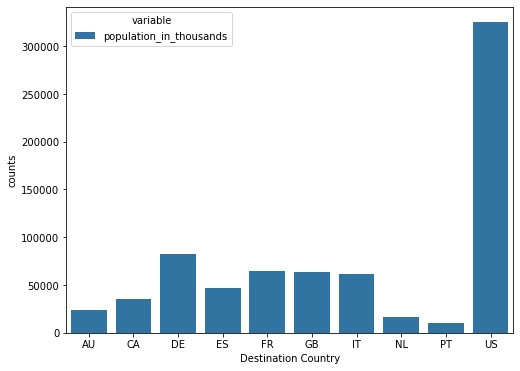

In [44]:
total=data4.groupby(by=["country_destination"]).aggregate({"population_in_thousands":"sum"})
res=total.reset_index()
res_wide=res.melt(id_vars="country_destination")
plt.figure(figsize=(8,6))
sns.barplot(x="country_destination", y="value",data=res_wide, hue="variable")
plt.xlabel("Destination Country")
plt.ylabel("counts")
plt.show()

The USA 'US' is the most visited country with population that exceeds 300000 users, and Portugal 'PT' is the least visited one with population less than 25000 users.

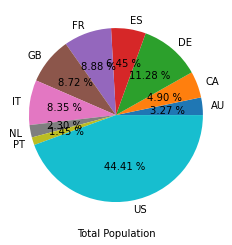

In [45]:
gb_sales2=data4.groupby(by="country_destination")[["population_in_thousands"]].sum()
res_2=gb_sales2.reset_index()
plt.pie(x="population_in_thousands",labels="country_destination", data=res_2, autopct="%.2f %%")
plt.xlabel("Total Population")
plt.show()

This pie chart shows that the most visited country is The USA 'US' with approximately 44.41% of the total population

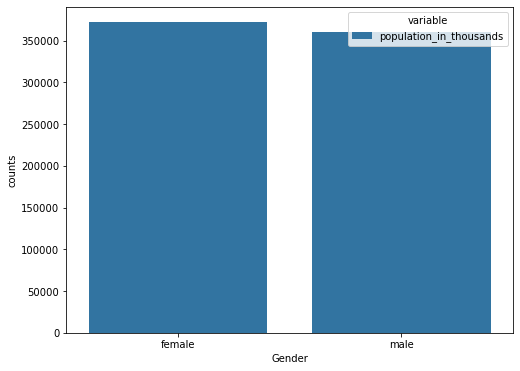

In [46]:
total=data4.groupby(by=["gender"]).aggregate({"population_in_thousands":"sum"})
res=total.reset_index()
res_wide=res.melt(id_vars="gender")
plt.figure(figsize=(8,6))
sns.barplot(x="gender", y="value",data=res_wide, hue="variable")
plt.xlabel("Gender")
plt.ylabel("counts")
plt.show()

This shows that female users represent the larger population tha exceeds 350000, while male users represent exactly 350000.

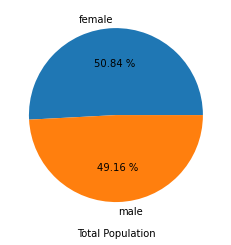

In [47]:
gb_sales2=data4.groupby(by="gender")[["population_in_thousands"]].sum()
res_2=gb_sales2.reset_index()
plt.pie(x="population_in_thousands",labels="gender", data=res_2, autopct="%.2f %%")
plt.xlabel("Total Population")
plt.show()

This shows that female users reprsent approximately 50.8% of the total population, and male users represent 49.16%

<Figure size 1080x720 with 0 Axes>

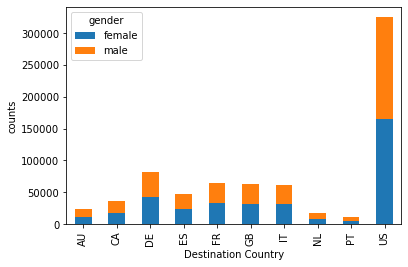

In [48]:
gb_sales3=data4.groupby(by=["country_destination", "gender"]).aggregate({"population_in_thousands":"sum"})
gb_res_3=gb_sales3.pivot_table(index="country_destination", columns="gender", values= "population_in_thousands")
plt.figure(figsize=(15,10))
gb_res_3.plot(kind="bar",stacked=True)
plt.xlabel("Destination Country")
plt.ylabel("counts")
plt.show()

This shows that most visited country is The USA 'US' with nearly equal ratio between male and female users

In [49]:
fig=px.bar(data4,x='age_bucket',y='population_in_thousands', color= "gender", barmode='group',
           labels={'age_bucket':'age_bucket','population_in_thousands':'population_in_thousands'})
fig.show()

This shows that the age_bucket '50-54' reprsents most of population with larger number of female users than that of male users.

In [50]:
ww= data4[['age_bucket','population_in_thousands','gender']]
fig=px.scatter_3d(ww,x="age_bucket",y="population_in_thousands",z='gender')
fig.show()

When hovering each bubble, three aggregates attributes are displayed which are 'age_bucket', 'poulation_in_thousands', and 'gender'

# 'Countries.csv' File

In [51]:
data5= pd.read_csv("countries.csv")
data5

,country_destination,lat_destination,lng_destination,distance_km,destination_km2,destination_language,language_levenshtein_distance
0,AU,-26.853388,133.275160,15297.7440,7741220.0,eng,0.00
1,CA,62.393303,-96.818146,2828.1333,9984670.0,eng,0.00
2,DE,51.165707,10.452764,7879.5680,357022.0,deu,72.61
3,ES,39.896027,-2.487694,7730.7240,505370.0,spa,92.25
4,FR,46.232193,2.209667,7682.9450,643801.0,fra,92.06
5,GB,54.633220,-3.432277,6883.6590,243610.0,eng,0.00
6,IT,41.873990,12.564167,8636.6310,301340.0,ita,89.40
7,NL,52.133057,5.295250,7524.3203,41543.0,nld,63.22
8,PT,39.553444,-7.839319,7355.2534,92090.0,por,95.45
9,US,36.966427,-95.844030,0.0000,9826675.0,eng,0.00


In [52]:
data5.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10 entries, 0 to 9
Data columns (total 7 columns):
 #   Column                         Non-Null Count  Dtype  
---  ------                         --------------  -----  
 0   country_destination            10 non-null     object 
 1   lat_destination                10 non-null     float64
 2   lng_destination                10 non-null     float64
 3   distance_km                    10 non-null     float64
 4   destination_km2                10 non-null     float64
 5   destination_language           10 non-null     object 
 6   language_levenshtein_distance  10 non-null     float64
dtypes: float64(5), object(2)
memory usage: 688.0+ bytes


### EDA Process

In [53]:
data5.describe()

,lat_destination,lng_destination,distance_km,destination_km2,language_levenshtein_distance
count,10.000000,10.000000,10.000000,1.000000e+01,10.00000
mean,39.799398,-4.262446,7181.897800,2.973734e+06,50.49900
std,24.739112,63.700585,3941.141734,4.329619e+06,44.54169
min,-26.853388,-96.818146,0.000000,4.154300e+04,0.00000
25%,39.639090,-6.737559,7001.557600,2.580425e+05,0.00000
50%,44.053092,-0.139014,7603.632650,4.311960e+05,67.91500
75%,51.891219,9.163386,7842.357000,5.966865e+06,91.39500
max,62.393303,133.275160,15297.744000,9.984670e+06,95.45000


In [54]:
fig = px.scatter_geo(data5, lat='lat_destination',lon='lng_destination', size="destination_km2",
                     hover_data={'lng_destination':False,'lat_destination':False, 'destination_km2': True,
                                 'country_destination':True, 'destination_language ':True })
fig.update_layout(title = 'Destination Countries', title_x=0.5)
fig.show()

In [55]:
fig = px.bar(data5, x='country_destination', y='distance_km',
             labels= {'country_destination': "Destination Country",
                     'distance_km': "Distance from USA (in kms)"})
fig.show()

In [56]:
fig = px.bar(data5, x='destination_language ', y='language_levenshtein_distance',
             labels= {'destination_language ': "Destination Language",
                     'language_levenshtein_distance': "Levenshtein Distances (w.r.t English)"})
fig.show()

# 'Train_users.csv' File

In [57]:
data= pd.read_csv("Airbnb_train_users.csv")
data

,id,date_account_created,timestamp_first_active,date_first_booking,gender,age,signup_method,signup_flow,language,affiliate_channel,affiliate_provider,first_affiliate_tracked,signup_app,first_device_type,first_browser,country_destination
0,gxn3p5htnn,2010-06-28,20090319043255,NaN,-unknown-,NaN,facebook,0,en,direct,direct,untracked,Web,Mac Desktop,Chrome,NDF
1,820tgsjxq7,2011-05-25,20090523174809,NaN,MALE,38.0,facebook,0,en,seo,google,untracked,Web,Mac Desktop,Chrome,NDF
2,4ft3gnwmtx,2010-09-28,20090609231247,2010-08-02,FEMALE,56.0,basic,3,en,direct,direct,untracked,Web,Windows Desktop,IE,US
3,bjjt8pjhuk,2011-12-05,20091031060129,2012-09-08,FEMALE,42.0,facebook,0,en,direct,direct,untracked,Web,Mac Desktop,Firefox,other
4,87mebub9p4,2010-09-14,20091208061105,2010-02-18,-unknown-,41.0,basic,0,en,direct,direct,untracked,Web,Mac Desktop,Chrome,US
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
213446,zxodksqpep,2014-06-30,20140630235636,NaN,MALE,32.0,basic,0,en,sem-brand,google,omg,Web,Mac Desktop,Safari,NDF
213447,mhewnxesx9,2014-06-30,20140630235719,NaN,-unknown-,NaN,basic,0,en,direct,direct,linked,Web,Windows Desktop,Chrome,NDF
213448,6o3arsjbb4,2014-06-30,20140630235754,NaN,-unknown-,32.0,basic,0,en,direct,direct,untracked,Web,Mac Desktop,Firefox,NDF
213449,jh95kwisub,2014-06-30,20140630235822,NaN,-unknown-,NaN,basic,25,en,other,other,tracked-other,iOS,iPhone,Mobile Safari,NDF


In [58]:
#to know the number of rows and columns
data.shape

(213451, 16)

In [59]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 213451 entries, 0 to 213450
Data columns (total 16 columns):
 #   Column                   Non-Null Count   Dtype  
---  ------                   --------------   -----  
 0   id                       213451 non-null  object 
 1   date_account_created     213451 non-null  object 
 2   timestamp_first_active   213451 non-null  int64  
 3   date_first_booking       88908 non-null   object 
 4   gender                   213451 non-null  object 
 5   age                      125461 non-null  float64
 6   signup_method            213451 non-null  object 
 7   signup_flow              213451 non-null  int64  
 8   language                 213451 non-null  object 
 9   affiliate_channel        213451 non-null  object 
 10  affiliate_provider       213451 non-null  object 
 11  first_affiliate_tracked  207386 non-null  object 
 12  signup_app               213451 non-null  object 
 13  first_device_type        213451 non-null  object 
 14  firs

### EDA Process

In [60]:
data.describe()

,timestamp_first_active,age,signup_flow
count,2.134510e+05,125461.000000,213451.000000
mean,2.013085e+13,49.668335,3.267387
std,9.253717e+09,155.666612,7.637707
min,2.009032e+13,1.000000,0.000000
25%,2.012123e+13,28.000000,0.000000
50%,2.013091e+13,34.000000,0.000000
75%,2.014031e+13,43.000000,0.000000
max,2.014063e+13,2014.000000,25.000000


In [61]:
#females more than males
data['gender'].value_counts()

-unknown-    95688
FEMALE       63041
MALE         54440
OTHER          282
Name: gender, dtype: int64

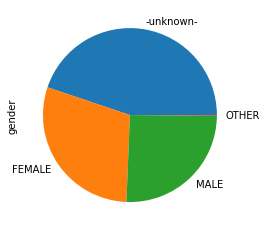

In [62]:
#The pie chart shows that females are more than males
data['gender'].value_counts().plot(kind='pie')
plt.show()

<AxesSubplot:>

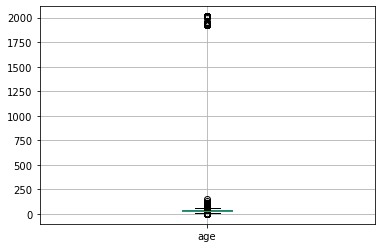

In [63]:
data[['age']].boxplot()

[]

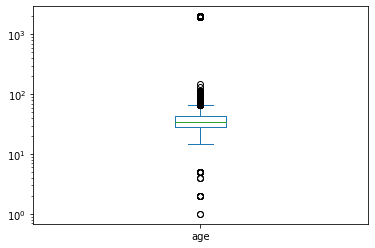

In [64]:
#Zooming through quartiles.
data['age'].plot(kind='box')
plt.semilogy()

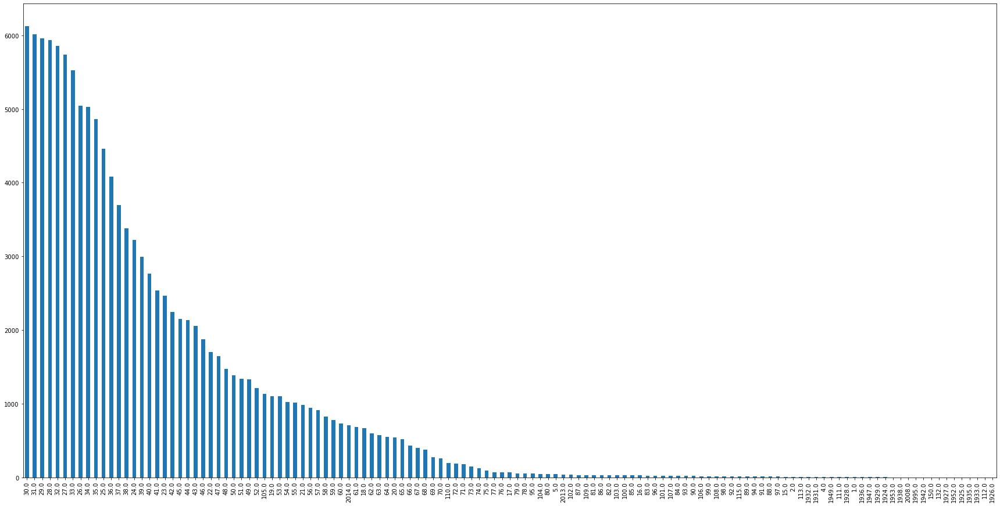

In [65]:
plt.figure(figsize=(30,15))
data.age.value_counts(dropna=True).plot(kind='bar')
plt.show()

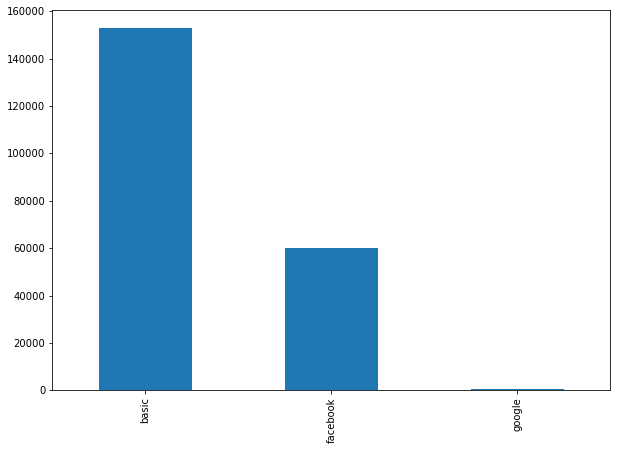

In [66]:
#This shows that the most used signup_method is basic and the least one is google
plt.figure(figsize=(10,7))
data.signup_method.value_counts(dropna=False).plot(kind='bar')
plt.show()

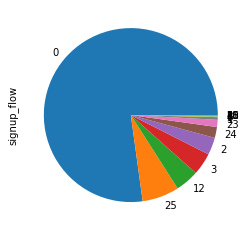

In [67]:
#This shows that that the most used is method is that they directly go to the booking browser
data.signup_flow.value_counts().plot(kind='pie')
plt.show()

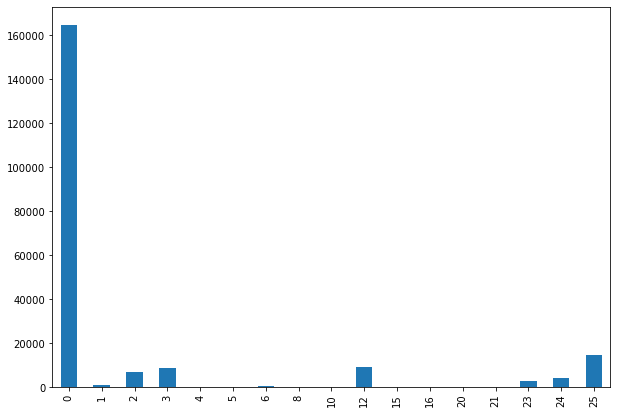

In [68]:
plt.figure(figsize=(10,7))
data['signup_flow'].value_counts(dropna=False).sort_index().plot(kind='bar')
plt.show()

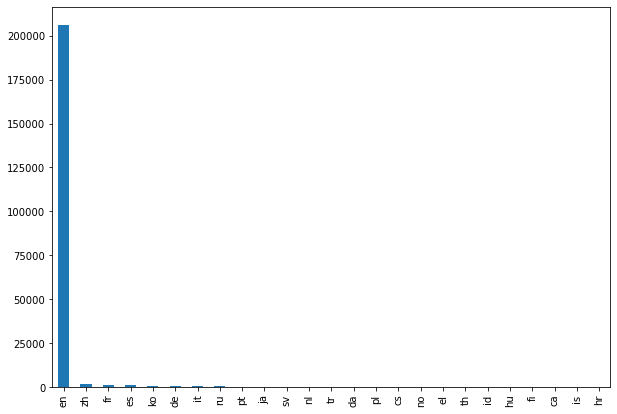

In [69]:
#The most used language is 'en' and the least one is 'hr'
plt.figure(figsize=(10,7))
data['language'].value_counts(dropna=False).plot(kind='bar')
plt.show()

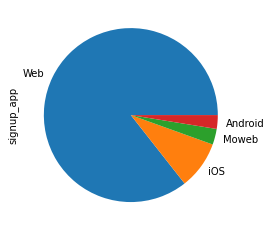

In [70]:
#The most used sign_up app is web and the least one is Android
data.signup_app.value_counts().plot(kind='pie')
plt.show()

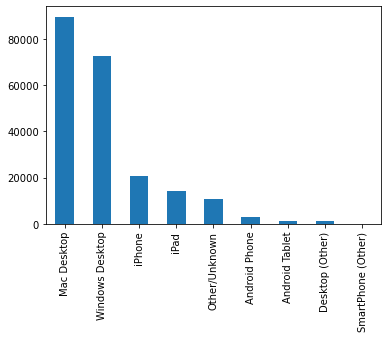

In [71]:
#That means that the most used first device type method is Mac Desktop 
data.first_device_type.value_counts(dropna=False).plot(kind='bar')
plt.show()

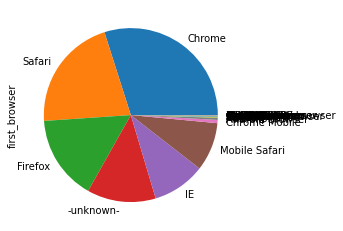

In [72]:
#This means that the most used browser is Chrome
data.first_browser.value_counts().plot(kind='pie')
plt.show()

In [73]:
ww= data[['affiliate_channel','affiliate_provider','first_affiliate_tracked']]
fig=px.scatter_3d(ww,x="affiliate_channel",y="affiliate_provider",z='first_affiliate_tracked')
fig.show()

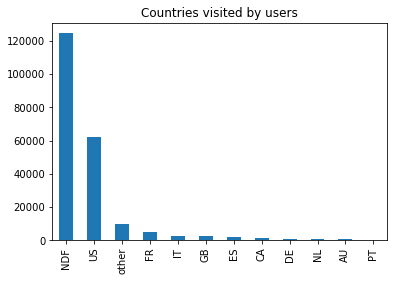

In [74]:
data.country_destination.value_counts().plot(kind='bar',title='Countries visited by users')
plt.show()

NDF means not defined so USA is the most visited country.

## Data Cleaning Process

In [75]:
data.isnull().sum()

id                              0
date_account_created            0
timestamp_first_active          0
date_first_booking         124543
gender                          0
age                         87990
signup_method                   0
signup_flow                     0
language                        0
affiliate_channel               0
affiliate_provider              0
first_affiliate_tracked      6065
signup_app                      0
first_device_type               0
first_browser                   0
country_destination             0
dtype: int64

In [76]:
# Dropping 'date_first_booking' column since more than 50% of its values are null.
data.drop('date_first_booking', axis=1, inplace= True)

In [77]:
#Checking for duplicates
data.duplicated().sum()

0

#### We got that 'date_account_created', and 'timestamp_first_active' fields are of type of object so we need to cast them into 'datetime'

In [78]:
#Wrong data type for 'date_account_created', and 'timestamp_first_active' fields.
data['date_account_created']=pd.to_datetime(data['date_account_created'])
data['timestamp_first_active']=pd.to_datetime(data['timestamp_first_active'], format='%Y%m%d%H%S%f')

In [79]:
#Here we made sure that they are casted into "datetime"
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 213451 entries, 0 to 213450
Data columns (total 15 columns):
 #   Column                   Non-Null Count   Dtype         
---  ------                   --------------   -----         
 0   id                       213451 non-null  object        
 1   date_account_created     213451 non-null  datetime64[ns]
 2   timestamp_first_active   213451 non-null  datetime64[ns]
 3   gender                   213451 non-null  object        
 4   age                      125461 non-null  float64       
 5   signup_method            213451 non-null  object        
 6   signup_flow              213451 non-null  int64         
 7   language                 213451 non-null  object        
 8   affiliate_channel        213451 non-null  object        
 9   affiliate_provider       213451 non-null  object        
 10  first_affiliate_tracked  207386 non-null  object        
 11  signup_app               213451 non-null  object        
 12  first_device_typ

### Detecting and Treating Outliers in  'age' column with Z-Score

In [80]:
data.age.describe()

count    125461.000000
mean         49.668335
std         155.666612
min           1.000000
25%          28.000000
50%          34.000000
75%          43.000000
max        2014.000000
Name: age, dtype: float64

In [81]:
#Replacing null values in 'age' column with the mode of values which is equal to 30.
data['age'].fillna(value=data['age'].mode()[0], inplace=True)

In [82]:
# 95% CI for the mean of 'age' before treating outliers.
st.norm.interval(alpha=0.95, loc=data.age.mean(), scale=st.sem(data.age))

(41.05258802079926, 42.06849363260129)

In [83]:
#Detecting and treating outliers with Z-Score method.
mean = np.mean(data['age'])
std = np.std(data['age'])
threshold = 3
outliers = []
for i in data['age']:
    z = (i-mean)/std
    if abs(z) > threshold:
        outliers.append(i)
        data['age'] = data['age'].replace([i], mean)

In [84]:
pd.DataFrame(outliers)

,0
0,2014.0
1,2014.0
2,2014.0
3,2013.0
4,2014.0
...,...
774,1938.0
775,1924.0
776,1947.0
777,1949.0


In [85]:
data.describe()

,age,signup_flow
count,213451.000000,213451.000000
mean,34.372618,3.267387
std,11.281939,7.637707
min,1.000000,0.000000
25%,30.000000,0.000000
50%,30.000000,0.000000
75%,36.000000,0.000000
max,150.000000,25.000000


In [86]:
# CI after treating outliers
st.norm.interval(alpha=0.95, loc=np.mean(data.age), scale=st.sem(data.age))

(34.324756781143755, 34.42047899947122)

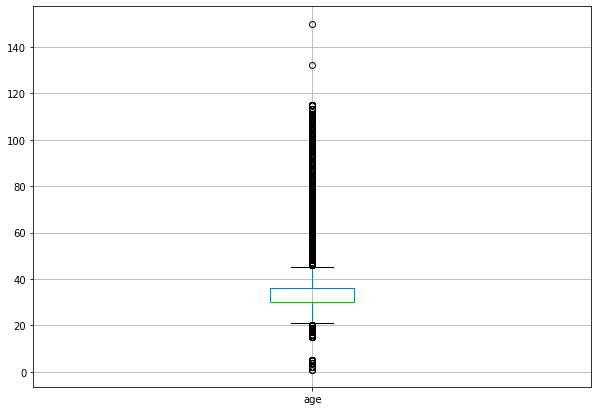

In [87]:
plt.figure(figsize=(10,7))
data[['age']].boxplot()
plt.show()

Notice the differnce between both boxplots of 'age' attribute before and after the cleaning process.

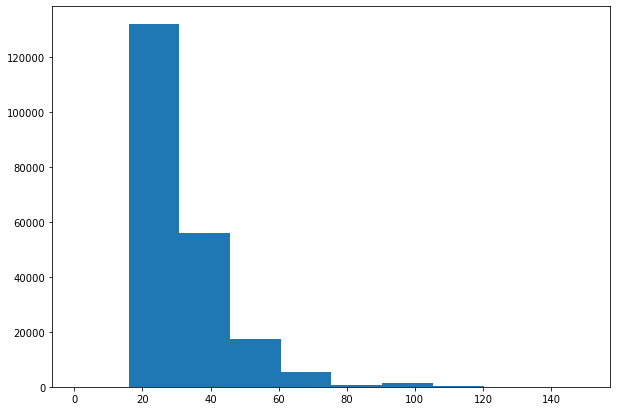

In [88]:
plt.figure(figsize=(10,7))
plt.hist(data['age'])
plt.show()

Notice that 'age' column values are right-skewed.

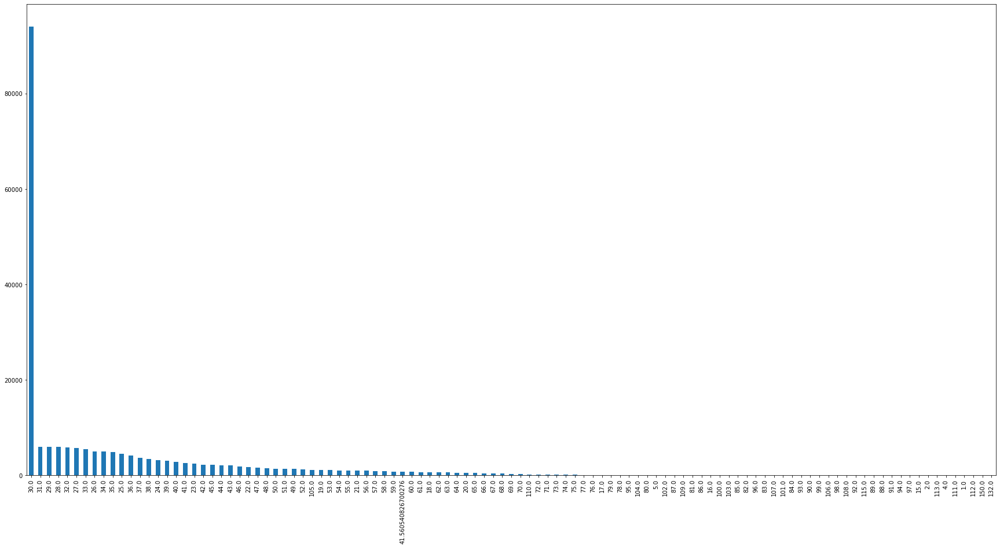

In [89]:
plt.figure(figsize=(30,15))
data.age.value_counts().plot(kind='bar')
plt.show()

#### There are  some outliers that were not handled by Z-Score method.

In [90]:
data['first_affiliate_tracked'].fillna(method='ffill', inplace=True)

In [91]:
data.isnull().sum()

id                         0
date_account_created       0
timestamp_first_active     0
gender                     0
age                        0
signup_method              0
signup_flow                0
language                   0
affiliate_channel          0
affiliate_provider         0
first_affiliate_tracked    0
signup_app                 0
first_device_type          0
first_browser              0
country_destination        0
dtype: int64

In [92]:
#Checking for duplicates
data.duplicated().sum()

0

## Time Series Analysis (Task 2)

In [93]:
from pylab import rcParams 
import statsmodels.api as sm
import itertools

In [94]:
#the first and last account created
print(data.date_account_created.min())
print(data.date_account_created.max())

2010-01-01 00:00:00
2014-06-30 00:00:00


In [95]:
data = data.sort_values('date_account_created')
data

,id,date_account_created,timestamp_first_active,gender,age,signup_method,signup_flow,language,affiliate_channel,affiliate_provider,first_affiliate_tracked,signup_app,first_device_type,first_browser,country_destination
5,osr2jwljor,2010-01-01,2010-01-01 21:00:56.190,-unknown-,30.0,basic,0,en,other,other,omg,Web,Mac Desktop,Chrome,US
6,lsw9q7uk0j,2010-01-02,2010-01-02 01:00:25.580,FEMALE,46.0,basic,0,en,other,craigslist,untracked,Web,Mac Desktop,Safari,US
7,0d01nltbrs,2010-01-03,2010-01-03 19:00:19.050,FEMALE,47.0,basic,0,en,direct,direct,omg,Web,Mac Desktop,Safari,US
9,6uh8zyj2gn,2010-01-04,2010-01-04 02:00:37.580,-unknown-,46.0,basic,0,en,other,craigslist,omg,Web,Mac Desktop,Firefox,US
8,a1vcnhxeij,2010-01-04,2010-01-04 00:00:42.110,FEMALE,50.0,basic,0,en,other,craigslist,untracked,Web,Mac Desktop,Safari,US
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
213058,mh5hsbjd87,2014-06-30,2014-06-30 06:00:04.140,-unknown-,19.0,basic,0,en,direct,direct,linked,Web,Windows Desktop,Chrome,US
213059,vma1roceml,2014-06-30,2014-06-30 06:00:04.580,-unknown-,30.0,basic,0,en,seo,google,linked,Web,Mac Desktop,Chrome,NDF
213060,2q7b6qgku6,2014-06-30,2014-06-30 06:00:07.000,MALE,22.0,basic,0,en,direct,direct,untracked,Web,Mac Desktop,Chrome,US
213044,bf30aejd8v,2014-06-30,2014-06-30 05:00:37.390,FEMALE,30.0,facebook,0,en,direct,direct,linked,Web,Mac Desktop,Safari,US


In [96]:
ts_data = data.groupby('date_account_created')['id'].count().reset_index()

In [97]:
ts_data

,date_account_created,id
0,2010-01-01,1
1,2010-01-02,1
2,2010-01-03,1
3,2010-01-04,3
4,2010-01-05,3
...,...,...
1629,2014-06-26,587
1630,2014-06-27,557
1631,2014-06-28,461
1632,2014-06-29,484


In [98]:
ts_data = ts_data.set_index('date_account_created')
ts_data.index

DatetimeIndex(['2010-01-01', '2010-01-02', '2010-01-03', '2010-01-04',
               '2010-01-05', '2010-01-07', '2010-01-08', '2010-01-10',
               '2010-01-11', '2010-01-12',
               ...
               '2014-06-21', '2014-06-22', '2014-06-23', '2014-06-24',
               '2014-06-25', '2014-06-26', '2014-06-27', '2014-06-28',
               '2014-06-29', '2014-06-30'],
              dtype='datetime64[ns]', name='date_account_created', length=1634, freq=None)

Our current datetime data can be tricky to work with, therefore, we will use the average daily users value for each month instead.   
We are using the beginnig of each month as the timestamp (first day of each month).

In [99]:
y = ts_data['id'].resample('MS').mean()

In [100]:
#Have a quick peek at 2014 users data.
y['2014':]

date_account_created
2014-01-01    358.419355
2014-02-01    355.964286
2014-03-01    388.967742
2014-04-01    422.966667
2014-05-01    480.483871
2014-06-01    524.866667
Freq: MS, Name: id, dtype: float64

In [101]:
#Have a quick peek at 2012, and 2013 users data.
y['2012':'2013']

date_account_created
2012-01-01     51.258065
2012-02-01     61.689655
2012-03-01     70.709677
2012-04-01     86.300000
2012-05-01    107.258065
2012-06-01    128.900000
2012-07-01    147.806452
2012-08-01    144.387097
2012-09-01    134.500000
2012-10-01    123.483871
2012-11-01    123.533333
2012-12-01    112.387097
2013-01-01    142.516129
2013-02-01    155.785714
2013-03-01    174.870968
2013-04-01    195.166667
2013-05-01    216.806452
2013-06-01    225.500000
2013-07-01    256.451613
2013-08-01    269.967742
2013-09-01    304.166667
2013-10-01    253.612903
2013-11-01    258.366667
2013-12-01    269.709677
Freq: MS, Name: id, dtype: float64

<b>Plot Analysis</b>

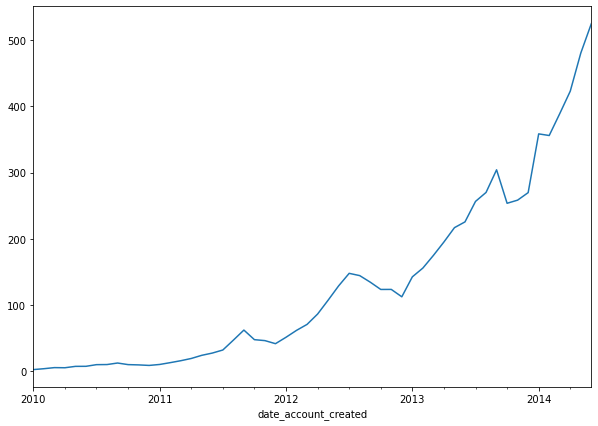

In [102]:
y.plot(figsize=(10, 7))
plt.show()

<b>Decomposition</b>

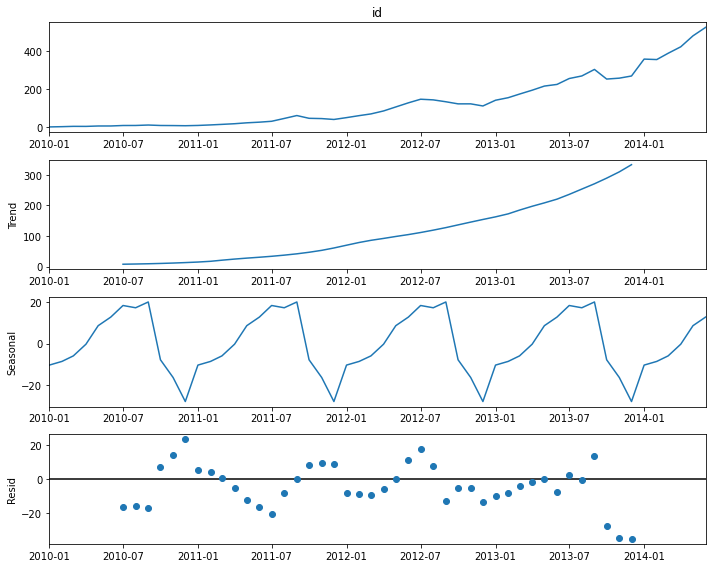

In [103]:
rcParams['figure.figsize'] = (10,8)
decomposition = sm.tsa.seasonal_decompose(y, model='additive')
fig = decomposition.plot()
plt.show()

In [104]:
p = d = q = range(0, 2)
pdq = list(itertools.product(p, d, q))
seasonal_pdq = [(x[0], x[1], x[2], 12) for x in list(itertools.product(p, d, q))]
print('Examples of parameter combinations for Seasonal ARIMA...')
print('SARIMAX: {} x {}'.format(pdq[1], seasonal_pdq[1]))
print('SARIMAX: {} x {}'.format(pdq[1], seasonal_pdq[2]))
print('SARIMAX: {} x {}'.format(pdq[2], seasonal_pdq[3]))
print('SARIMAX: {} x {}'.format(pdq[2], seasonal_pdq[4]))

Examples of parameter combinations for Seasonal ARIMA...
SARIMAX: (0, 0, 1) x (0, 0, 1, 12)
SARIMAX: (0, 0, 1) x (0, 1, 0, 12)
SARIMAX: (0, 1, 0) x (0, 1, 1, 12)
SARIMAX: (0, 1, 0) x (1, 0, 0, 12)


In [105]:
for param in pdq:
    for param_seasonal in seasonal_pdq:
        try:
            mod =sm.tsa.statespace.SARIMAX(y,order=param,seasonal_order=param_seasonal,enforce_stationarity=False,enforce_invertibility=False)
            results=mod.fit()
            print('ARIMA{}x{}12 - AIC:{}'.format(param, param_seasonal, results.aic))
        except:
            continue


ARIMA(0, 0, 0)x(0, 0, 0, 12)12 - AIC:708.3608302166832
ARIMA(0, 0, 0)x(0, 0, 1, 12)12 - AIC:545.1860326328887
ARIMA(0, 0, 0)x(0, 1, 0, 12)12 - AIC:511.85635805983105


C:\Users\yarae\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals



ARIMA(0, 0, 0)x(0, 1, 1, 12)12 - AIC:1254.089820411174
ARIMA(0, 0, 0)x(1, 0, 0, 12)12 - AIC:413.59807479587874
ARIMA(0, 0, 0)x(1, 0, 1, 12)12 - AIC:405.34130848863134
ARIMA(0, 0, 0)x(1, 1, 0, 12)12 - AIC:320.703187658354
ARIMA(0, 0, 0)x(1, 1, 1, 12)12 - AIC:299.87076361794834
ARIMA(0, 0, 1)x(0, 0, 0, 12)12 - AIC:639.4336902147865
ARIMA(0, 0, 1)x(0, 0, 1, 12)12 - AIC:491.13912114969565
ARIMA(0, 0, 1)x(0, 1, 0, 12)12 - AIC:458.7666980632658
ARIMA(0, 0, 1)x(0, 1, 1, 12)12 - AIC:1309.1848490498164
ARIMA(0, 0, 1)x(1, 0, 0, 12)12 - AIC:382.5865690417562
ARIMA(0, 0, 1)x(1, 0, 1, 12)12 - AIC:365.97564036873246
ARIMA(0, 0, 1)x(1, 1, 0, 12)12 - AIC:301.69698175283594
ARIMA(0, 0, 1)x(1, 1, 1, 12)12 - AIC:272.82220440220067
ARIMA(0, 1, 0)x(0, 0, 0, 12)12 - AIC:472.2546286221796
ARIMA(0, 1, 0)x(0, 0, 1, 12)12 - AIC:370.59167479087466
ARIMA(0, 1, 0)x(0, 1, 0, 12)12 - AIC:351.2977282552737


C:\Users\yarae\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals

C:\Users\yarae\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals



ARIMA(0, 1, 0)x(0, 1, 1, 12)12 - AIC:1078.0161279348542
ARIMA(0, 1, 0)x(1, 0, 0, 12)12 - AIC:356.218965045777
ARIMA(0, 1, 0)x(1, 0, 1, 12)12 - AIC:340.53300027364537
ARIMA(0, 1, 0)x(1, 1, 0, 12)12 - AIC:264.70311155283264
ARIMA(0, 1, 0)x(1, 1, 1, 12)12 - AIC:1326.6458303543861
ARIMA(0, 1, 1)x(0, 0, 0, 12)12 - AIC:462.61692844590385
ARIMA(0, 1, 1)x(0, 0, 1, 12)12 - AIC:362.2916251577544
ARIMA(0, 1, 1)x(0, 1, 0, 12)12 - AIC:344.6359632157673


C:\Users\yarae\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals



ARIMA(0, 1, 1)x(0, 1, 1, 12)12 - AIC:1093.395323945607
ARIMA(0, 1, 1)x(1, 0, 0, 12)12 - AIC:357.4985727379714
ARIMA(0, 1, 1)x(1, 0, 1, 12)12 - AIC:335.03047568098236
ARIMA(0, 1, 1)x(1, 1, 0, 12)12 - AIC:266.09205697209404


C:\Users\yarae\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals

C:\Users\yarae\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals



ARIMA(0, 1, 1)x(1, 1, 1, 12)12 - AIC:1054.943790681889
ARIMA(1, 0, 0)x(0, 0, 0, 12)12 - AIC:457.69425461559376
ARIMA(1, 0, 0)x(0, 0, 1, 12)12 - AIC:363.8458788100261
ARIMA(1, 0, 0)x(0, 1, 0, 12)12 - AIC:352.4640707646549


C:\Users\yarae\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals



ARIMA(1, 0, 0)x(0, 1, 1, 12)12 - AIC:1250.4928266671475
ARIMA(1, 0, 0)x(1, 0, 0, 12)12 - AIC:354.36919828740594
ARIMA(1, 0, 0)x(1, 0, 1, 12)12 - AIC:350.110983516263
ARIMA(1, 0, 0)x(1, 1, 0, 12)12 - AIC:258.5625595437903
ARIMA(1, 0, 0)x(1, 1, 1, 12)12 - AIC:261.69217377951765
ARIMA(1, 0, 1)x(0, 0, 0, 12)12 - AIC:451.86703271532514
ARIMA(1, 0, 1)x(0, 0, 1, 12)12 - AIC:357.7394090706015
ARIMA(1, 0, 1)x(0, 1, 0, 12)12 - AIC:346.5426953765132
ARIMA(1, 0, 1)x(0, 1, 1, 12)12 - AIC:1311.1848490498162
ARIMA(1, 0, 1)x(1, 0, 0, 12)12 - AIC:358.3843035002797
ARIMA(1, 0, 1)x(1, 0, 1, 12)12 - AIC:343.18639941536856
ARIMA(1, 0, 1)x(1, 1, 0, 12)12 - AIC:259.89256538971296
ARIMA(1, 0, 1)x(1, 1, 1, 12)12 - AIC:267.25455391057807
ARIMA(1, 1, 0)x(0, 0, 0, 12)12 - AIC:467.5178013761862
ARIMA(1, 1, 0)x(0, 0, 1, 12)12 - AIC:368.89985957189424
ARIMA(1, 1, 0)x(0, 1, 0, 12)12 - AIC:352.2478333529036


C:\Users\yarae\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals



ARIMA(1, 1, 0)x(0, 1, 1, 12)12 - AIC:1330.0964680350887
ARIMA(1, 1, 0)x(1, 0, 0, 12)12 - AIC:350.15959399828216
ARIMA(1, 1, 0)x(1, 0, 1, 12)12 - AIC:342.529463396668
ARIMA(1, 1, 0)x(1, 1, 0, 12)12 - AIC:257.7500401764952


C:\Users\yarae\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals



ARIMA(1, 1, 0)x(1, 1, 1, 12)12 - AIC:1288.6160686281607
ARIMA(1, 1, 1)x(0, 0, 0, 12)12 - AIC:447.7434015871352
ARIMA(1, 1, 1)x(0, 0, 1, 12)12 - AIC:352.7920715402101
ARIMA(1, 1, 1)x(0, 1, 0, 12)12 - AIC:342.35756653112804


C:\Users\yarae\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals



ARIMA(1, 1, 1)x(0, 1, 1, 12)12 - AIC:1307.0232283649266
ARIMA(1, 1, 1)x(1, 0, 0, 12)12 - AIC:351.8192138873369
ARIMA(1, 1, 1)x(1, 0, 1, 12)12 - AIC:335.5194137081121
ARIMA(1, 1, 1)x(1, 1, 0, 12)12 - AIC:256.07843038825405
ARIMA(1, 1, 1)x(1, 1, 1, 12)12 - AIC:1267.0977478725845


C:\Users\yarae\anaconda3\lib\site-packages\statsmodels\base\model.py:604: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals



### The previous output suggests that SARIMAX(1, 1, 1)x(1, 1, 0, 12) yields the lowest AIC of value 256.07. Therefore, we should consider this to be an optimal option.

In [106]:
mod = sm.tsa.statespace.SARIMAX(y,
                                order=(1, 1, 1),
                                seasonal_order=(1, 1, 0, 12),
                                enforce_stationarity=False,
                                enforce_invertibility=False)
results = mod.fit()
print(results.summary().tables[1])


                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          1.0516      0.045     23.401      0.000       0.964       1.140
ma.L1         -1.0000      0.224     -4.464      0.000      -1.439      -0.561
ar.S.L12      -0.5106      0.364     -1.401      0.161      -1.225       0.204
sigma2       366.1485      0.001   5.98e+05      0.000     366.147     366.150


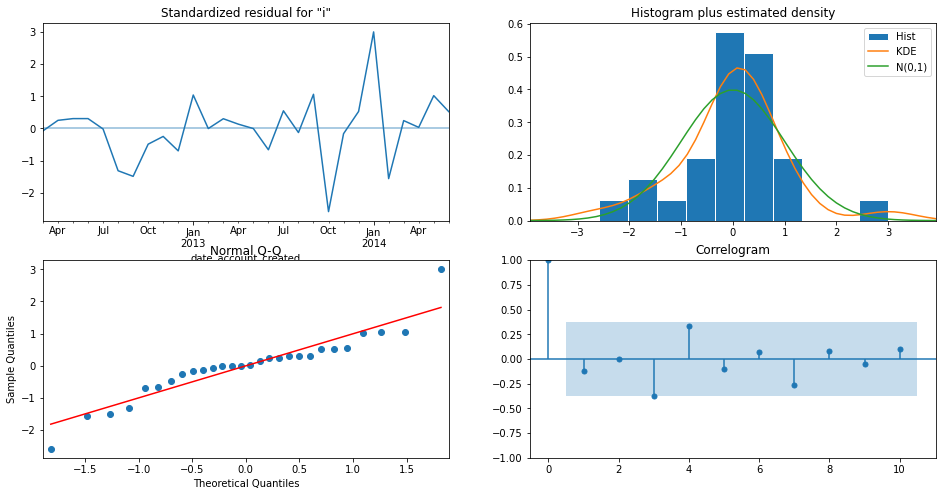

In [107]:
results.plot_diagnostics(figsize=(16, 8))
plt.show()

From the above Normal Q-Q plot, we got that the redisuals are most likely to be normally distributed, but still it's 
not that perfect as the points at the 2 tails deviate a little bit from the straight line.

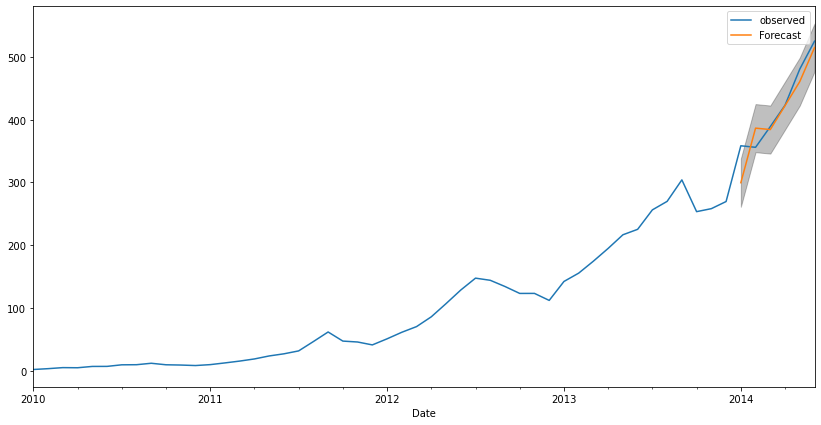

In [108]:
#predicting how many accounts will be created starting from 2014
pred = results.get_prediction(start=pd.to_datetime('2014-01-01'), dynamic=False)
#We’ll also want to add confidence intervals to our graph
pred_ci = pred.conf_int()
#I’ll  plot the observed values in our dataset (plotting the data of the Y variable)
ax = y.plot(label='observed', figsize=(14, 7)) 
#plotting the predicted data
pred.predicted_mean.plot(ax=ax, label='Forecast') 
"""the pred_ci represents the confidence interval of our prediction so it includes the lower and the upper bounds such that
column[0] is the lower bound and column[1] is the upper bound"""
ax.fill_between(pred_ci.index,
                pred_ci.iloc[:, 0],
                pred_ci.iloc[:, 1], color='k', alpha=.25) 

ax.set_xlabel('Date')
plt.legend()
plt.show()

In [109]:
#Examining the raw data for our predicted confidence intervals
print(pred_ci)

                        lower id    upper id
date_account_created                        
2014-01-01            261.342886  337.962732
2014-02-01            348.226231  424.779637
2014-03-01            345.970426  422.462653
2014-04-01            384.114734  460.550441
2014-05-01            422.392475  498.775809
2014-06-01            476.525615  552.860282


## Machine Learning Models (Task 3)

Most of the attributes in 'train' dataset are categorical attributes (object).

Therefor, they should be converted to numeric attributes to be able to calculate the correlation coefficient.

.cat.codes converts the attributes from a string representation into an integer representation (1-1 Correspondence).

In [110]:
data['date_account_created']=data['date_account_created'].astype('category').cat.codes
data['timestamp_first_active']=data['timestamp_first_active'].astype('category').cat.codes
data['gender']=data['gender'].astype('category').cat.codes
data['signup_method']=data['signup_method'].astype('category').cat.codes
data['language']=data['language'].astype('category').cat.codes
data['affiliate_channel']=data['affiliate_channel'].astype('category').cat.codes
data['affiliate_provider']=data['affiliate_provider'].astype('category').cat.codes
data['first_affiliate_tracked']=data['first_affiliate_tracked'].astype('category').cat.codes
data['signup_app']=data['signup_app'].astype('category').cat.codes
data['first_device_type']=data['first_device_type'].astype('category').cat.codes
data['first_browser']=data['first_browser'].astype('category').cat.codes
c = data['country_destination'].astype('category')
data['country_destination']=data['country_destination'].astype('category').cat.codes
data.head()

,id,date_account_created,timestamp_first_active,gender,age,signup_method,signup_flow,language,affiliate_channel,affiliate_provider,first_affiliate_tracked,signup_app,first_device_type,first_browser,country_destination
5,osr2jwljor,0,5,0,30.0,0,0,5,3,12,3,2,3,8,10
6,lsw9q7uk0j,1,6,1,46.0,0,0,5,3,2,6,2,3,41,10
7,0d01nltbrs,2,7,1,47.0,0,0,5,2,4,3,2,3,41,10
9,6uh8zyj2gn,3,9,0,46.0,0,0,5,3,2,3,2,3,17,10
8,a1vcnhxeij,3,8,1,50.0,0,0,5,3,2,6,2,3,41,10


In [111]:
# Calculating the correlation between each two attributes and storing the values in a new dataframe 'corrs'.
corrs=data.corr(method='pearson')
# The 'corrs'dataframe indicates the correlation matrix.
corrs

,date_account_created,timestamp_first_active,gender,age,signup_method,signup_flow,language,affiliate_channel,affiliate_provider,first_affiliate_tracked,signup_app,first_device_type,first_browser,country_destination
date_account_created,1.000000,0.939663,-0.113035,-0.071178,-0.073589,0.202204,0.032947,-0.026034,0.017983,0.023165,0.020117,0.090519,-0.026452,-0.022723
timestamp_first_active,0.939663,1.000000,-0.129202,-0.077487,-0.080725,0.235801,0.032644,-0.002629,0.002382,0.030255,0.027604,0.092863,-0.062610,-0.019059
gender,-0.113035,-0.129202,1.000000,0.200822,0.472487,-0.088581,0.010677,-0.043536,0.039029,-0.003319,0.019923,-0.053382,-0.000827,0.101418
age,-0.071178,-0.077487,0.200822,1.000000,0.093759,-0.090424,-0.032387,0.059789,0.018650,-0.032990,-0.003360,-0.010286,0.080480,0.036950
signup_method,-0.073589,-0.080725,0.472487,0.093759,1.000000,-0.043973,0.035879,-0.070480,0.090465,-0.000169,-0.022857,-0.050309,-0.030846,-0.011452
signup_flow,0.202204,0.235801,-0.088581,-0.090424,-0.043973,1.000000,0.006192,-0.259989,-0.040266,0.203866,0.132692,0.293492,-0.327023,-0.031561
language,0.032947,0.032644,0.010677,-0.032387,0.035879,0.006192,1.000000,-0.006276,0.018873,-0.006203,-0.001458,0.028984,-0.023983,-0.005491
affiliate_channel,-0.026034,-0.002629,-0.043536,0.059789,-0.070480,-0.259989,-0.006276,1.000000,0.383490,-0.258195,0.009486,-0.045639,0.087013,-0.007044
affiliate_provider,0.017983,0.002382,0.039029,0.018650,0.090465,-0.040266,0.018873,0.383490,1.000000,-0.113070,-0.075161,0.010041,-0.012979,-0.016407
first_affiliate_tracked,0.023165,0.030255,-0.003319,-0.032990,-0.000169,0.203866,-0.006203,-0.258195,-0.113070,1.000000,0.025145,0.090639,-0.148575,0.004320


### Plotting a correlation (heat) map to interpret the values of the correlated and uncorrelated columns

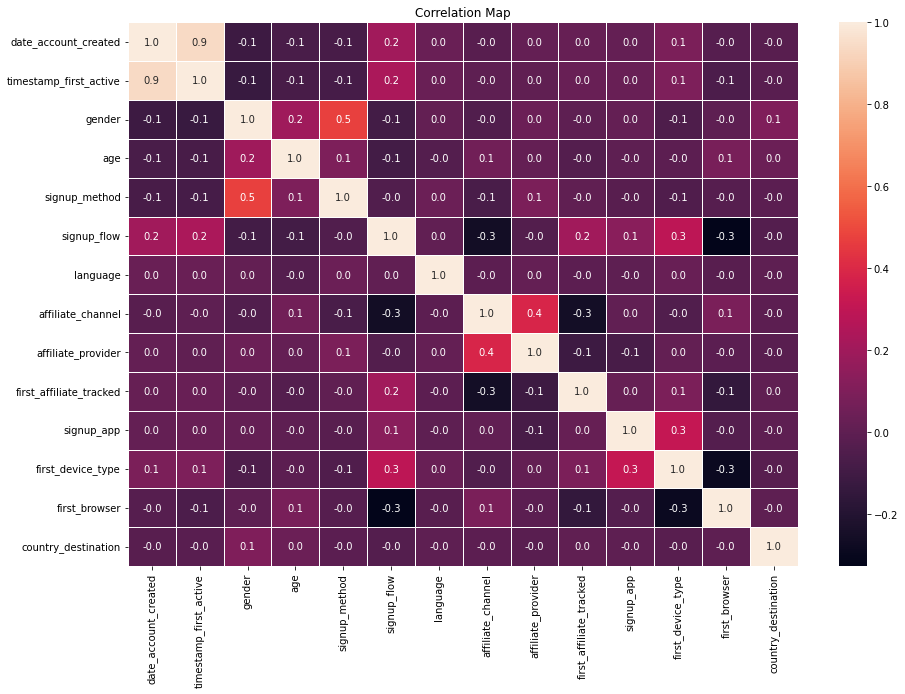

In [112]:
# Controls the figure size.
f,ax = plt.subplots(figsize=(15, 10)) 
# Annot shows the value of the correlated index.
sns.heatmap(corrs, annot=True, linewidths=.5, fmt= '.1f',ax=ax) 
plt.title("Correlation Map")
plt.show()

Dropping 'timestamp_first_active' column since it is highly-correlated with 'date_account_created' column as they will probably lead to the same results in predictions.

In [113]:
data.drop(['timestamp_first_active'], axis=1, inplace= True)
#Dropping 'id' column
data.drop(['id'], axis=1, inplace= True)

In [114]:
data

,date_account_created,gender,age,signup_method,signup_flow,language,affiliate_channel,affiliate_provider,first_affiliate_tracked,signup_app,first_device_type,first_browser,country_destination
5,0,0,30.0,0,0,5,3,12,3,2,3,8,10
6,1,1,46.0,0,0,5,3,2,6,2,3,41,10
7,2,1,47.0,0,0,5,2,4,3,2,3,41,10
9,3,0,46.0,0,0,5,3,2,3,2,3,17,10
8,3,1,50.0,0,0,5,3,2,6,2,3,41,10
...,...,...,...,...,...,...,...,...,...,...,...,...,...
213058,1633,0,19.0,0,0,5,2,4,0,2,6,8,10
213059,1633,0,30.0,0,0,5,7,8,0,2,3,8,7
213060,1633,2,22.0,0,0,5,2,4,6,2,3,8,10
213044,1633,1,30.0,1,0,5,2,4,0,2,3,41,10


#### Mapping each country in 'country_destination' to the code (number) representing it.

In [115]:
d = pd.DataFrame(enumerate(c.cat.categories))
d.rename(columns = {0:'Code', 1:'Country'}, inplace = True)
d

,Code,Country
0,0,AU
1,1,CA
2,2,DE
3,3,ES
4,4,FR
5,5,GB
6,6,IT
7,7,NDF
8,8,NL
9,9,PT


### Splitting the dataset into train and test datasets

In [116]:
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn import metrics
from sklearn.metrics import accuracy_score
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report

In [117]:
# Defining a function to split the dataset.
def splitdataset(df):
# Separating the target variable.
    X = df.values[:, 0:len(df)-2]
    Y = df.values[:, -1]

# Splitting the dataset into train and test.    
    X_train, X_test, y_train, y_test = train_test_split( 
    X, Y, test_size = 0.2, random_state = 100)
    sc= StandardScaler()
    X_train= sc.fit_transform(X_train)
    X_test= sc.fit_transform(X_test)
        
    return X, Y, X_train, X_test, y_train, y_test

In [118]:
# Defining a function to show the connfusion matrix, accuracy, and classification report of the predictions.
def cal_accuracy(y_test, y_pred):
    cm= confusion_matrix(y_test, y_pred)
    
    print("Confusion Matrix: ", cm)
      
    print ("Accuracy: ",
    accuracy_score(y_test,y_pred)*100, '%')
      
    print("Report: ",
    classification_report(y_test, y_pred))   

In [119]:
# Defining a function to plot the confusion matrix by a heat map
def plot_cm (cm):
    # Creating a dataframe for a array-formatted Confusion matrix,so it will be easy for plotting.
    cm_df = pd.DataFrame(cm,
                     index = ['AU', 'CA', 'DE', 'ES', 'FR', 'GB', 'IT', 'NDF', 'NL', 'PT', 'US', 'other'], 
                     columns = ['AU', 'CA', 'DE', 'ES', 'FR', 'GB', 'IT', 'NDF', 'NL', 'PT', 'US', 'other'])
    #Plotting the confusion matrix
    plt.figure(figsize=(15,7))
    sns.heatmap(cm_df, annot=True, linewidths=.5, fmt= '.1f')
    plt.title('Confusion Matrix')
    plt.ylabel('Actal Values')
    plt.xlabel('Predicted Values')
    plt.show()

In [120]:
# Defining a function to calculate balanced-accuracy of the predictions.
def balanced_accuracy(cm):
    FP = cm.sum(axis=0) - np.diag(cm) 
    FN = cm.sum(axis=1) - np.diag(cm)
    TP = np.diag(cm)
    TN = cm.sum() - (FP + FN + TP)
    FP = FP.astype(float)
    FN = FN.astype(float)
    TP = TP.astype(float)
    TN = TN.astype(float)
    # Sensitivity, hit rate, recall, or true positive rate
    TPR = TP/(TP+FN)
    # Specificity or true negative rate
    TNR = TN/(TN+FP) 
    # Overall accuracy for each class
    ACC = (TP+TN)/(TP+FP+FN+TN)
    # Balanced accuracy for each class
    bal_acc= (TPR+TNR)/2
    print("Balanced-Accuracy= ", bal_acc.mean()*100, " %")
    return bal_acc

### Dataset Splitting

In [121]:
X, Y, X_train, X_test, y_train, y_test = splitdataset(data)

## KNN Algorithm

In [122]:
from sklearn.neighbors import KNeighborsClassifier

In [123]:
# Initiating an object 'knn' from 'KNeighborsClassifier' class.
knn = KNeighborsClassifier(n_neighbors = 5)

In [124]:
# Step 1: Training.
knn.fit(X_train, y_train)

KNeighborsClassifier()

In [125]:
# Getting the training data accuracy.
print("Accuracy: ", knn.score(X_train, y_train)*100,"%")

Accuracy:  96.28250175685173 %


In [126]:
# Step 2: Classification (Prediction).
y_pred1= knn.predict(X_test)

In [127]:
# Getting the test (predicted) data accuracy.
cm_knn=cal_accuracy(y_test, y_pred1)
cm_knn

Confusion Matrix:  [[   42    75     4     0     1     1     0     0     0     0     0     0]
 [   24   212    28    10     6     0     0     1     0     0     0     0]
 [    2    55    85    54    18     0     0     4     0     0     0     0]
 [    0     2    21   264   151     7     1    12     0     0     0     0]
 [    0     1     2    66   823    37     4    38     0     0     0     0]
 [    0     0     0     1   163   219    20    72     0     0     0     0]
 [    0     0     0     0     0     3   205   361     0     0     0     0]
 [    0     0     0     0     0     0     1 24871     0     0     5     0]
 [    0     0     0     0     0     0     0   119    12     0     1     0]
 [    0     0     0     0     0     0     0     2     1     0    44     0]
 [    0     0     0     0     0     0     0    60     0     0 12467     8]
 [    0     0     0     0     0     0     0     4     0     0   722  1279]]
Accuracy:  94.81858002857744 %
Report:                precision    recall  f1-sc

C:\Users\yarae\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

C:\Users\yarae\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

C:\Users\yarae\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



In [128]:
# Creating  a confusion matrix that compares the y_test and y_pred1
cm1= confusion_matrix(y_test, y_pred1)

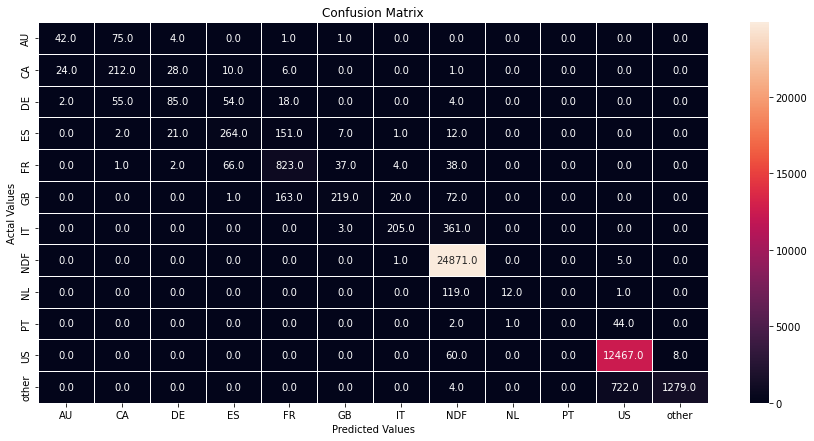

In [130]:
plot_cm(cm1)

In [131]:
balanced_accuracy(cm1)

Balanced-Accuracy=  76.552825668756  %


array([0.67042631, 0.87565617, 0.69430666, 0.78665869, 0.91972711,
       0.72995781, 0.67983197, 0.98098977, 0.5454428 , 0.5       ,
       0.98448749, 0.8188543 ])

## Decision Tree Algorithm

In [132]:
from sklearn.tree import DecisionTreeClassifier

### Decision Tree with 'Gini Index' Method

In [133]:
# Creating the classifier object
clf_gini = DecisionTreeClassifier(criterion = "gini", random_state = 100, max_depth=3, min_samples_leaf=5)

In [134]:
# Step 1: Training.
clf_gini.fit(X_train, y_train)

DecisionTreeClassifier(max_depth=3, min_samples_leaf=5, random_state=100)

In [135]:
# Step 2: Classification (Prediction).
y_pred2 = clf_gini.predict(X_test)

In [136]:
# Getting the test (predicted) data accuracy.
cm_dt1= cal_accuracy(y_test, y_pred2)
cm_dt1

Confusion Matrix:  [[    0     0     0     0   123     0     0     0     0     0     0     0]
 [    0     0     0     0   281     0     0     0     0     0     0     0]
 [    0     0     0     0   218     0     0     0     0     0     0     0]
 [    0     0     0     0   458     0     0     0     0     0     0     0]
 [    0     0     0     0   971     0     0     0     0     0     0     0]
 [    0     0     0     0   475     0     0     0     0     0     0     0]
 [    0     0     0     0     0     0   569     0     0     0     0     0]
 [    0     0     0     0     0     0     0 24877     0     0     0     0]
 [    0     0     0     0     0     0     0     0   132     0     0     0]
 [    0     0     0     0     0     0     0     0    47     0     0     0]
 [    0     0     0     0     0     0     0     0     0     0 12535     0]
 [    0     0     0     0     0     0     0     0     0     0     0  2005]]
Accuracy:  96.24745262467499 %
Report:                precision    recall  f1-sc

C:\Users\yarae\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

C:\Users\yarae\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

C:\Users\yarae\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



In [137]:
# Creating  a confusion matrix that compares the y_test and y_pred2
cm2= confusion_matrix(y_test, y_pred2)

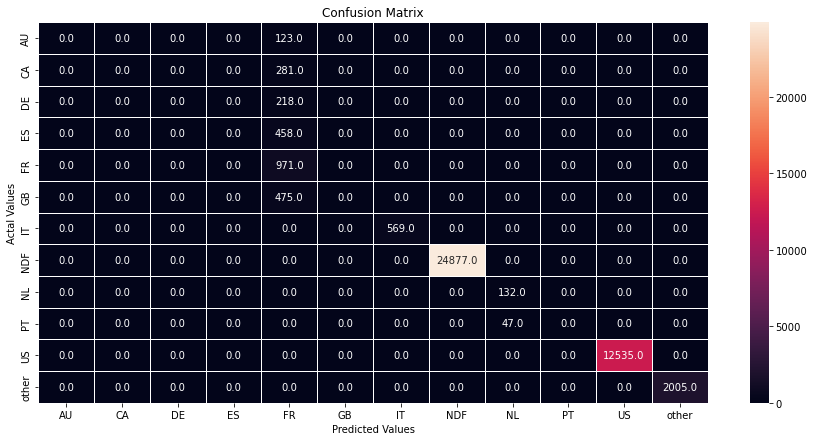

In [138]:
plot_cm(cm2)

In [139]:
balanced_accuracy(cm2)

Balanced-Accuracy=  74.8400973303198  %


array([0.5       , 0.5       , 0.5       , 0.5       , 0.98136385,
       0.5       , 1.        , 1.        , 0.99944783, 0.5       ,
       1.        , 1.        ])

### Decision Tree with 'Entropy' Method

In [140]:
# Creating the classifier object
clf_entropy = DecisionTreeClassifier(criterion = "entropy", random_state = 100, max_depth = 3, min_samples_leaf = 5)

In [141]:
# Step 1: Training.
clf_entropy.fit(X_train, y_train)

DecisionTreeClassifier(criterion='entropy', max_depth=3, min_samples_leaf=5,
                       random_state=100)

In [142]:
# Step 2: Classification (Prediction).
y_pred3 = clf_entropy.predict(X_test)

In [143]:
# Getting the test (predicted) data accuracy.
cm_dt2= cal_accuracy(y_test, y_pred3)
cm_dt2

Confusion Matrix:  [[    0     0     0   123     0     0     0     0     0     0     0     0]
 [    0     0     0   281     0     0     0     0     0     0     0     0]
 [    0     0     0   218     0     0     0     0     0     0     0     0]
 [    0     0     0   458     0     0     0     0     0     0     0     0]
 [    0     0     0     0   971     0     0     0     0     0     0     0]
 [    0     0     0     0   475     0     0     0     0     0     0     0]
 [    0     0     0     0   569     0     0     0     0     0     0     0]
 [    0     0     0     0     0     0     0 24877     0     0     0     0]
 [    0     0     0     0     0     0     0     0   132     0     0     0]
 [    0     0     0     0     0     0     0     0    47     0     0     0]
 [    0     0     0     0     0     0     0     0     0     0 12535     0]
 [    0     0     0     0     0     0     0     0     0     0     0  2005]]
Accuracy:  95.98744466046708 %
Report:                precision    recall  f1-sc

C:\Users\yarae\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

C:\Users\yarae\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

C:\Users\yarae\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



In [144]:
# Creating  a confusion matrix that compares the y_test and y_pred3
cm3= confusion_matrix(y_test, y_pred3)

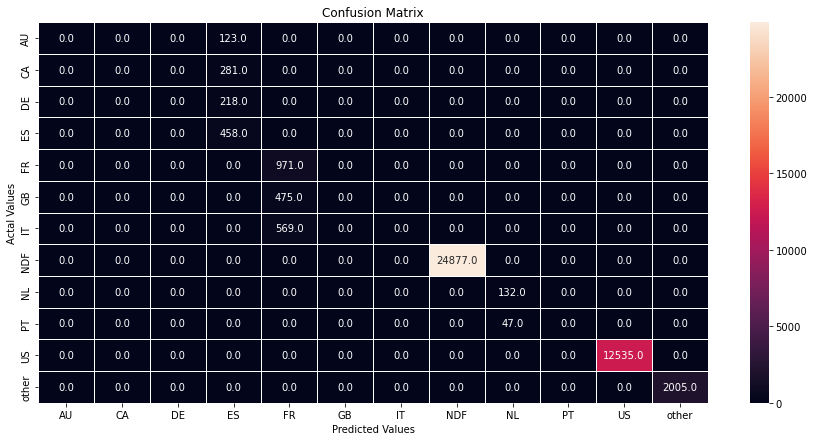

In [145]:
# PLotting the cofusion matrix
plot_cm(cm3)

In [146]:
balanced_accuracy(cm3)

Balanced-Accuracy=  74.82976609144475  %


array([0.5       , 0.5       , 0.5       , 0.99263609, 0.98748802,
       0.5       , 0.5       , 1.        , 0.99944783, 0.5       ,
       1.        , 1.        ])

## Naive Bayes Algorithm

In [147]:
# Importing Library.
from sklearn.naive_bayes import GaussianNB

In [148]:
# Initiating an object 'nb' from 'GaussianNB' class.
nb=GaussianNB()

In [149]:
# Step 1: Training.
nb.fit(X_train, y_train)

GaussianNB()

In [150]:
# Getting the training data accuracy.
print("Accuracy: ", nb.score(X_train, y_train))

Accuracy:  1.0


In [151]:
# Step 2: Classification (Prediction).
y_pred4=nb.predict(X_test)

In [152]:
# Getting the test (predicted) data accuracy.
cm_nb= cal_accuracy(y_test, y_pred4)
cm_nb

Confusion Matrix:  [[  123     0     0     0     0     0     0     0     0     0     0     0]
 [    0   281     0     0     0     0     0     0     0     0     0     0]
 [    0     0   218     0     0     0     0     0     0     0     0     0]
 [    0     0     0   458     0     0     0     0     0     0     0     0]
 [    0     0     0     0   971     0     0     0     0     0     0     0]
 [    0     0     0     0     0   475     0     0     0     0     0     0]
 [    0     0     0     0     0     0   569     0     0     0     0     0]
 [    0     0     0     0     0     0     0 24877     0     0     0     0]
 [    0     0     0     0     0     0     0     0   132     0     0     0]
 [    0     0     0     0     0     0     0     0     0    47     0     0]
 [    0     0     0     0     0     0     0     0     0     0 12535     0]
 [    0     0     0     0     0     0     0     0     0     0     0  2005]]
Accuracy:  100.0 %
Report:                precision    recall  f1-score   suppor

In [153]:
# Creating  a confusion matrix that compares the y_test and y_pred4
cm4= confusion_matrix(y_test, y_pred4)

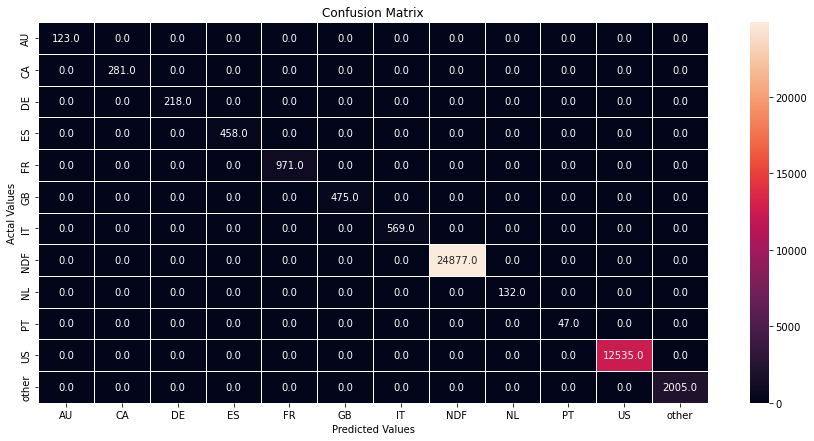

In [154]:
# PLotting the cofusion matrix
plot_cm(cm4)

In [155]:
balanced_accuracy(cm4)

Balanced-Accuracy=  100.0  %


array([1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1., 1.])

This shows certain over-fitting